In [2]:
import pandas as pd

In [3]:
queries_df = pd.read_csv("./MTG-QBH/metadata/Queries.csv")


In [4]:
queries_df.head()

,Filename,Query ID,Song ID,Title,Original artist,Class label
0,q1.wav,q1,1118,Mother natures son,The Beatles,mothernat
1,q2.wav,q2,1438,Scarborough fair,Unknown,scarborou
2,q3.wav,q3,1546,Stairway to heaven,Led Zeppelin,stairway2h
3,q4.wav,q4,1579,Strawberry fields forever,The Beatles,strawberry
4,q5.wav,q5,1808,When I am sixty four,The Beatles,whenim64


In [6]:
queries_df.sort_values(by="Song ID")

,Filename,Query ID,Song ID,Title,Original artist,Class label
52,q53.wav,q53,14,Dos gardenias,Bobby Capo,2gardeni
21,q22.wav,q22,19,Across the universe,The Beatles,across
11,q12.wav,q12,19,Across the universe,The Beatles,across
19,q20.wav,q20,60,Agua de beber,Vinicius de Moraes,aguabeber
117,q118.wav,q118,70,All my loving,The Beatles,allmyloving
...,...,...,...,...,...,...
12,q13.wav,q13,2133,More than words,Extreme,morethwor
51,q52.wav,q52,2146,Proud Mary,Creedence Clearwater Revival,proudmary
6,q7.wav,q7,2179,The boxer,Simon and Garfunkel,theboxer
94,q95.wav,q95,2208,That will be the day,The Crickets,thatllbetd


In [4]:
queries_df.groupby("Song ID").size().to_frame("count").sort_values(by='count', ascending=False)

,count
Song ID,
1224,4
941,4
2056,3
1564,3
995,3
...,...
1252,1
1396,1
1411,1


In [14]:
queries_df[queries_df["Song ID"]==1224]

,Filename,Query ID,Song ID,Title,Original artist,Class label
8,q9.wav,q9,1224,Ob la di ob la da,The Beatles,obladi
20,q21.wav,q21,1224,Ob la di ob la da,The Beatles,obladi
37,q38.wav,q38,1224,Ob la di ob la da,The Beatles,obladi
70,q71.wav,q71,1224,Ob la di ob la da,The Beatles,obladi


In [13]:
queries_df.shape

(118, 6)

In [11]:
songs_df = pd.read_csv("./MTG-QBH/metadata/Collection_Canonicals.csv", encoding='latin1')

In [12]:
songs_df.head()

,Song ID,Title,Artist,Original artist,Canonical,Class label
0,1,One hundred years,The Cure,The Cure,YES,100years
1,4,10:15 saturday night,The Cure,The Cure,YES,1015sat
2,7,Seventeen seconds,The Cure,The Cure,YES,17secs
3,14,Dos gardenias,Antonio Machin,Bobby Capo,YES,2gardeni
4,15,Six different ways,The Cure,The Cure,YES,6different


In [14]:
songs_df.shape

(481, 6)

In [23]:
!pip install librosa

In [24]:
!pip install basic-pitch

  Obtaining dependency information for basic-pitch from https://files.pythonhosted.org/packages/9b/38/905934ba7db4313b9942a84a5b82fe20cb2e384391d9d6cb7b8d92caa54b/basic_pitch-0.2.6-py2.py3-none-any.whl.metadata
  Using cached numpy-1.23.5-cp311-cp311-macosx_11_0_arm64.whl (13.3 MB)
  Using cached pretty_midi-0.2.10-py3-none-any.whl
  Using cached resampy-0.4.2-py3-none-any.whl (3.1 MB)
  Obtaining dependency information for mido>=1.1.16 from https://files.pythonhosted.org/packages/39/2c/df005c4b310dde2c834431032139bf2c3924f81798013feb052d1afd543b/mido-1.3.2-py3-none-any.whl.metadata
  Obtaining dependency information for keras<2.14,>=2.13.1 from https://files.pythonhosted.org/packages/2e/f3/19da7511b45e80216cbbd9467137b2d28919c58ba1ccb971435cb631e470/keras-2.13.1-py3-none-any.whl.metadata
  Using cached keras-2.13.1-py3-none-any.whl.metadata (2.4 kB)
  Obtaining dependency information for packaging from https://files.pythonhosted.org/packages/ec/1a/610693ac4ee14fcdf2d9bf3c493370e4f2ef7

In [25]:
!pip install -U demucs

  Using cached demucs-4.0.1-py3-none-any.whl
  Using cached dora_search-0.1.12-py3-none-any.whl
  Obtaining dependency information for einops from https://files.pythonhosted.org/packages/29/0b/2d1c0ebfd092e25935b86509a9a817159212d82aa43d7fb07eca4eeff2c2/einops-0.7.0-py3-none-any.whl.metadata
  Using cached julius-0.2.7-py3-none-any.whl
  Obtaining dependency information for lameenc>=1.2 from https://files.pythonhosted.org/packages/96/8f/c99a423cc6ff6ca3dec4d5a42a5bdac8fecdf3c3a52fc8fee2252af74ac4/lameenc-1.7.0-cp311-cp311-macosx_11_0_arm64.whl.metadata
  Using cached openunmix-1.2.1-py3-none-any.whl (46 kB)
  Obtaining dependency information for torch>=1.8.1 from https://files.pythonhosted.org/packages/1e/86/477ec85bf1f122931f00a2f3889ed9322c091497415a563291ffc119dacc/torch-2.1.2-cp311-none-macosx_11_0_arm64.whl.metadata
  Obtaining dependency information for torchaudio>=0.8 from https://files.pythonhosted.org/packages/42/e6/cd2386ff0bb1476c472593a77ca1870cbbddef901e63b04cc84ccd368da7/

In [16]:
!pip install mir_eval

  Using cached mir_eval-0.7-py3-none-any.whl


<Axes: >

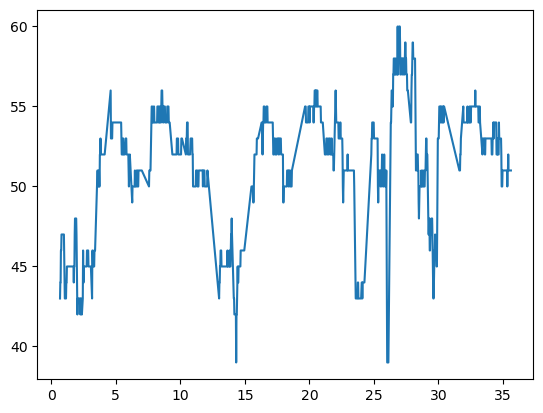

In [8]:
import librosa
import numpy as np
from IPython.display import display
from IPython.display import Audio
import seaborn as sns
import matplotlib.pyplot as plt

import mir_eval.sonify

import matplotlib.pyplot as plt

def display_wav(y, sr):
    fig, ax = plt.subplots(nrows=3, sharex=True)
    librosa.display.waveshow(y, sr=sr, ax=ax[0])
    ax[0].set(title='Audio')
    ax[0].label_outer()
    display(fig)
    
def extract_melody(y_wav, sr):
    f0, voiced_flag, voiced_probs = librosa.yin(y_wav, fmin=librosa.note_to_hz('C2'),fmax=librosa.note_to_hz('C7'))
    
    display_wav(y_wav, sr);
    
    onset_frames = librosa.onset.onset_detect(y=y_wav, sr=sr, units='frames')
    
    # print(onset_frames)
    
    onset_time = librosa.onset.onset_detect(y=y_wav, sr=sr, units='time')
    
    # print(onset_time)
    
    times = librosa.times_like(f0, sr=sr)
    vneg = (-1)**(~voiced_flag)
    f0_masked = np.ma.MaskedArray(f0, mask=~voiced_flag).compressed()
    times_masked = np.ma.MaskedArray(times, mask=~voiced_flag).compressed()
    midi_melody = librosa.hz_to_midi(f0_masked)
    midi_melody = np.round(midi_melody)
    
    melody_freq = librosa.midi_to_hz(midi_melody)
    y_f0 = mir_eval.sonify.pitch_contour(times_masked, melody_freq, sr )
    display(Audio(data=y_f0, rate=sr))

def query_by_humming(query_filename):
    y_raw, sr = librosa.load(f"MTG-QBH/audio/{query_filename}")
    
    # extract_melody(y_raw, sr)
    
    # y_raw, sr = librosa.load(librosa.ex('trumpet'))
    f0, voiced_flag, voiced_probs = librosa.pyin(y_raw, fmin=librosa.note_to_hz('C2'),fmax=librosa.note_to_hz('C7'))
    
    # f0 = librosa.yin(y_raw, fmin=librosa.note_to_hz('C2'),fmax=librosa.note_to_hz('C6'))
    # print(sr)
    # print(voiced_flag)
    # print(voiced_probs)
    times = librosa.times_like(f0, sr=sr)
    
    # print(times)
    # vneg = (-1)**(~voiced_flag)
    
    
    # print(f0)
    f0_masked = np.ma.MaskedArray(f0, mask=~voiced_flag).compressed()
    # f0_masked = f0
    times_masked = np.ma.MaskedArray(times, mask=~voiced_flag).compressed()
    # times_masked = times
    
    midi_melody = librosa.hz_to_midi(f0_masked)
    midi_melody = np.round(midi_melody)
#     print(midi_melody)
#     print(f0_masked)
#     print(midi_melody.shape)
#     print(f0_masked.shape)
    
    # display(sns.lineplot(x=times_masked,y=f0_masked))
    display(sns.lineplot(x=times_masked,y=midi_melody))
    chroma = librosa.feature.chroma_stft(y=y_raw, sr=sr)
    
    duration_total = librosa.get_duration(y=y_raw, sr=sr)
    frame_duration = duration_total/chroma.shape[1]
    times_segment = frame_duration * (1 + np.arange(chroma.shape[1]))
    
    # And sonify the f0 using mir_eval
    y_f0 = mir_eval.sonify.pitch_contour(times_masked, f0_masked, sr)
    
    display(Audio(data=y_f0, rate=sr))
    # y_f0 = mir_eval.sonify.clicks(times_masked, sr)
    # print(frame_duration)
    # y_f0 = mir_eval.sonify.chroma(chroma,times_segment, fs=sr)
    
    # tempo, beats = librosa.beat.beat_track(y=y_raw, sr=sr)
    # times = librosa.frames_to_time(beats, sr=sr)
    
    # times = librosa.onset.onset_detect(y=y_raw, sr=sr, units='time', backtrack=True, normalize=True)
    
    # y_f0 = mir_eval.sonify.clicks(times, sr)
    
    midi_melody = librosa.hz_to_midi(f0_masked)
    midi_melody = np.round(midi_melody)
    
    melody_freq = librosa.midi_to_hz(midi_melody)
    y_f1 = mir_eval.sonify.pitch_contour(times_masked, melody_freq, sr )
    
    display(Audio(data=y_f1, rate=sr))
    display(Audio(data=y_f0, rate=sr))
    display(Audio(data=y_raw, rate=sr))

    # img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time')
    # display(img)
    
query_by_humming('q28.wav')

<Axes: >

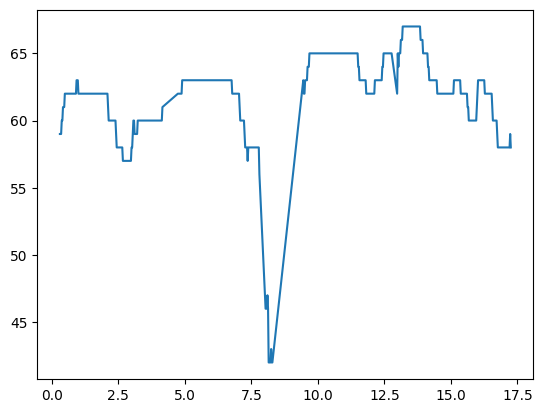

In [18]:
query_by_humming('q9.wav')

<Axes: >

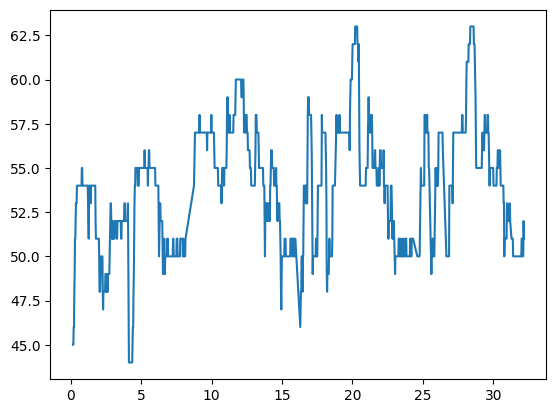

In [19]:
query_by_humming('q21.wav')

<Axes: >

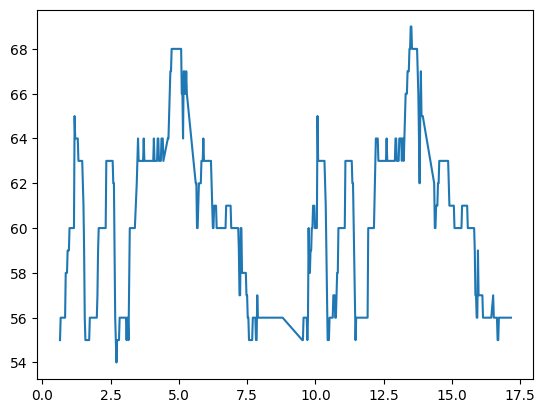

In [20]:
query_by_humming("q38.wav")

<Axes: >

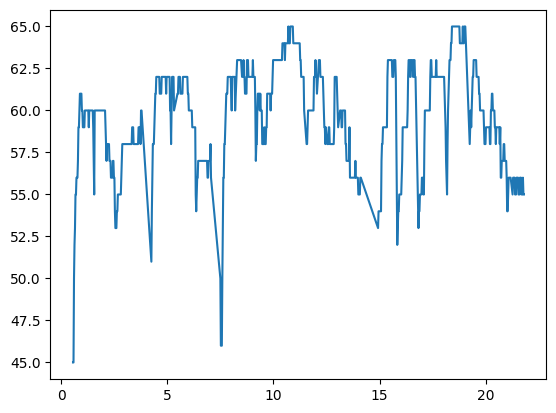

In [21]:
query_by_humming("q71.wav")

In [ ]:
def pitch_to_midi(freqs):
    return 

In [ ]:
query_by_humming('q2.wav')

<Axes: >

0.023212695150002446


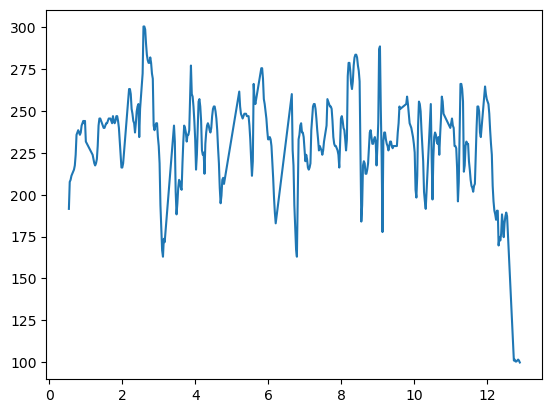

In [81]:
query_by_humming('q30.wav')

In [12]:
from basic_pitch.inference import p
from basic_pitch import ICASSP_2022_MODEL_PATH

def wav_to_midi(query_file):
    model_output, midi_data, note_events = predict(f"MTG-QBH/audio/{query_file}")
    y_raw, sr = librosa.load(f"MTG-QBH/audio/{query_file}")
    wav = midi_data.synthesize()
    display(Audio(data=wav, rate=44100))
    display(Audio(data=y_raw, rate=sr))

    display(midi_data.key_signature_changes)
    display(midi_data.get_downbeats())
    display(midi_data.get_onsets())
    display(midi_data.get_end_time())

    print(type( midi_data.instruments[0].notes))
    durations = list(map(lambda x: x.duration, midi_data.instruments[0].notes))
    durations = np.asarray(durations)
    display(sns.histplot(durations, bins=100))
    display(min(durations))
    display(max(durations))

    display(len(durations))
    display((durations>0.14).sum())

    print(midi_data.instruments[0].notes[0].duration)
    filtered_notes = []
    for note in midi_data.instruments[0].notes:
        if(note.duration > 0.24):
            filtered_notes.append(note)
    midi_data.instruments[0].notes = filtered_notes


    wav2 = midi_data.synthesize()
    display(Audio(data=wav2, rate=44100))


Predicting MIDI for MTG-QBH/audio/q71.wav...


[]

array([ 0.,  2.,  4.,  6.,  8., 10., 12., 14., 16., 18., 20.])

array([ 1.1261678 ,  1.33514739,  1.67183673,  2.12590975,  2.32327937,
        2.6135288 ,  2.8689483 ,  3.39139728,  3.60037687,  4.43757914,
        4.51884898,  4.71621859,  4.9716381 ,  5.4824771 ,  5.79594649,
        5.95977007,  6.16874966,  6.40094921,  7.80575646,  8.02762993,
        8.27143946,  8.503639  ,  8.82871837,  8.97964807,  9.23506757,
        9.50209705,  9.68785669, 10.03743991, 10.52505896, 10.89657823,
       11.09394785, 11.60478685, 12.15173968, 12.52325896, 13.15019773,
       13.60298685, 15.13678776, 15.35737732, 15.8798263 , 16.06686984,
       16.3455093 , 16.86795828, 17.12337778, 17.41362721, 17.85480635,
       18.37853923, 18.73844853, 19.37699728, 19.69046667, 19.86461633,
       19.99360998, 20.22580952, 20.46961905, 20.75986848, 21.03850794,
       21.35197732, 21.50290703])

21.65383673469388

<class 'list'>


<Axes: ylabel='Count'>

0.12899365079365133

0.5108390022675735

57

52

0.20897959183673476


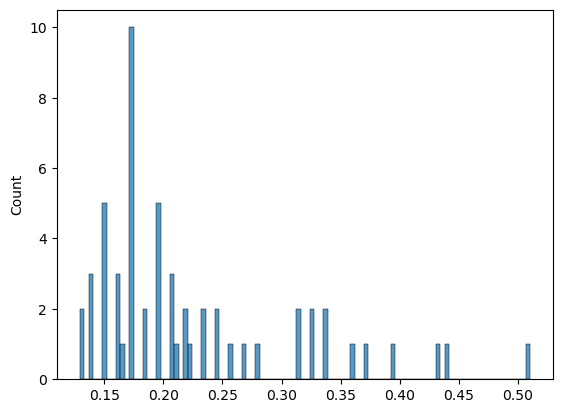

In [13]:
wav_to_midi("q71.wav")

In [ ]:
cache = {}

In [80]:
from basic_pitch.inference import predict
from basic_pitch import ICASSP_2022_MODEL_PATH
import nltk
from nltk.util import ngrams


def get_overlap_coef(a,b):
    a_set = set(a)
    b_set = set(b)
    inter_set = a_set.intersection(b_set)
    return len(inter_set)/min(len(a_set),len(b_set))
def get_n_gram_from_notes(notes, n):
    result = []
    l = len(notes)
    for idx, note in enumerate(notes):
        if(idx+1<l-1):
            diff = note.pitch - notes[idx+1].pitch
            diff = str(diff)
            result.append(diff)
    n_grams = ngrams(result, n)
    return [' '.join(grams) for grams in n_grams]      

def get_midi_n_grams(midi, n):
    result = []
    for inst in midi.instruments:
        if(not inst.is_drum):
            n_grams = get_n_gram_from_notes(inst.notes,n)
            result = result+n_grams
    return result

def get_query_wav(query_id):
    y_raw, sr = librosa.load(f"MTG-QBH/audio/{query_id}.wav")
    return y_raw, sr
def get_song_wav(song_id):
    y = {}
    y["vocals"], sr = librosa.load(f"output/htdemucs/{song_id}/vocals.wav")
    y["drums"], _ = librosa.load(f"output/htdemucs/{song_id}/drums.wav")
    y["other"],_ = librosa.load(f"output/htdemucs/{song_id}/other.wav")
    return y, sr
def get_query_basic_midi(query_id):
    if(query_id+"q" in cache):
        return cache[query_id+"q"]
    model_output, midi_data, note_events = predict(f"MTG-QBH/audio/{query_id}.wav")
    cache[query_id+"q"] = midi_data
    return midi_data
def get_song_basic_midi(song_id):
    if(song_id+"s" in cache):
        return cache[song_id+"s"]
    model_output, vocal_midi_data, note_events = predict(f"output/htdemucs/{song_id}/vocals.wav")
    cache[song_id+"s"] = vocal_midi_data
    return vocal_midi_data

def query_wav_to_midi(query_wav):
    return None

def song_wav_to_midi(song_wav):
    return None

def similarity_basic(query_id, song_id):
    # query_y, query_sr = get_query_wav(query_id)
    # song_y, song_sr = get_song_wav(song_id)
    
    query_midi = get_query_basic_midi(query_id)
    song_midi = get_song_basic_midi(song_id)
    
#     query_midi_wav = query_midi.synthesize()
#     song_midi_wav = song_midi.synthesize()
    
#     display(Audio(data=query_y, rate=query_sr))
#     display(Audio(data=song_y["vocals"], rate=song_sr))
#     display(Audio(data=query_midi_wav, rate=44100))
#     display(Audio(data=song_midi_wav, rate=44100))
    
    query_grams = get_midi_n_grams(query_midi,4)
    query_grams = query_grams + get_midi_n_grams(query_midi,3)
    query_grams = query_grams + get_midi_n_grams(query_midi,5)
    
    song_grams = get_midi_n_grams(song_midi,4)
    song_grams = song_grams+get_midi_n_grams(song_midi,3)
    song_grams = song_grams+get_midi_n_grams(song_midi,5)
    
    return get_overlap_coef(query_grams, song_grams)
    
similarity_basic("q12", "19")

0.4110429447852761

In [59]:
test_songs_df = pd.DataFrame({"songId":["1","14","15","4","7", "19", "60"]})
test_queries_df = pd.DataFrame({"queryId":["q53","q22","q12","q20"]})
test_df = test_queries_df.merge(test_songs_df, how='cross')
test_df

,queryId,songId
0,q53,1
1,q53,14
2,q53,15
3,q53,4
4,q53,7
5,q53,19
6,q53,60
7,q22,1
8,q22,14
9,q22,15


In [81]:
test_df["similarity"] = test_df.apply(lambda x: similarity_basic(x["queryId"],x["songId"]), axis=1)
test_df.sort_values(by="similarity", ascending=False)

,queryId,songId,similarity
19,q12,19,0.411043
26,q20,19,0.233766
22,q20,14,0.214286
12,q22,19,0.203704
14,q12,1,0.128834
15,q12,14,0.128834
27,q20,60,0.123377
1,q53,14,0.112500
5,q53,19,0.112500
8,q22,14,0.111111


In [61]:
queries_df.sort_values(by="Song ID")

,Filename,Query ID,Song ID,Title,Original artist,Class label
52,q53.wav,q53,14,Dos gardenias,Bobby Capo,2gardeni
21,q22.wav,q22,19,Across the universe,The Beatles,across
11,q12.wav,q12,19,Across the universe,The Beatles,across
19,q20.wav,q20,60,Agua de beber,Vinicius de Moraes,aguabeber
117,q118.wav,q118,70,All my loving,The Beatles,allmyloving
...,...,...,...,...,...,...
12,q13.wav,q13,2133,More than words,Extreme,morethwor
51,q52.wav,q52,2146,Proud Mary,Creedence Clearwater Revival,proudmary
6,q7.wav,q7,2179,The boxer,Simon and Garfunkel,theboxer
94,q95.wav,q95,2208,That will be the day,The Crickets,thatllbetd
